## Tile processing logic:
 - tiff is transformed to numpy array,
 - image is cut into separate pictures 384 * 384 (for model in .pth format it is possible to use sizes that are multiple of 32),
 - for each of them model predict mask,
 - they are concatenated into a binary mask,
 - the mask is converted to polygons,
 - polygons are filtered by size,
 - internal and external polygons are detected,
 - according to this, the final geo-polygons are calculaited in shapely.geometry.Polygon format

### [Single prediction](#single)
 - An example of one tile processing.
 
### [Different image sizes for big burnt areas](#sizes)
 - For large burnt areas, it makes sense to increase the size of the prediction images to 512/1024 pixels.
 - This reduces the detail of the boundaries, but increases their accuracy.

### [Batch processing - tiles from test region](#batch)
 - Batch processing example.

### [Converting model.pth to "onnx" format](#convert)
 - example of converting model to .onnx format (for Fires-Triton-Server)


## Логика обработки тайлов:
 - tiff переводится в numpy,
 - режется на отдельные картинки размером 384*384 (для модели в формате .pth можно любой размер кратный 32),
 - для каждой из них получается предсказание модели,
 - они склеиваются в бинарную маску,
 - маска переводится в полигоны,
 - полигоны фильтруются по размеру,
 - находится список внутренних и внешних полигонов,
 - по этому списку выдаются финальные геополигоны в формате shapely.geometry.Polygon
 
### [Single prediction](#single)
 - Пример обработки одного тайла
 
### [Different image sizes for big burnt areas](#sizes)
 - Для больших выгоревших площадей имеет смысл увеличить размер изображений для предсказания до 512/1024 пикселей.
 - Это уменьшает детальность границ, но увеличивает их точность.

### [Batch processing - tiles from test region](#batch)
 - Пример пакетной обработки.
 
### [Converting model.pth to "onnx" format](#convert)
 - Пример перевода модели в .onnx формат (для Fires-Triton-Server)

In [1]:
import glob
import os
import shutil

import matplotlib.pyplot as plt
import numpy as np
import tritonclient.http as httpclient
from IPython.core.interactiveshell import InteractiveShell
from tqdm import tqdm

from utils.detect import *
from utils.onnx_convert import pth_to_onnx

InteractiveShell.ast_node_interactivity = "all"

In [2]:
# 172.17.0.1 is always a host of a docker container
TRITON_HTTP_SERVICE_URL = "172.17.0.1:18000"
TORCH_MODEL_PATH = "/app/models/model1.pth"
CHANELS = ["B11", "B08", "B02"]
TIFF_PATH = [
    x.replace("response.tiff", "") for x in glob.glob("/app/data/test_tiff/*/*.tiff")
]

In [3]:
TRITON = True

In [4]:
triton_client = httpclient.InferenceServerClient(
    url=TRITON_HTTP_SERVICE_URL,
    verbose=False,
    connection_timeout=600,  # may be needed to wait for tensorrt to run optimization on first call
    network_timeout=600,
    concurrency=1,
)
triton_client.get_model_repository_index()

[{'name': 'ensemble_384', 'version': '1', 'state': 'READY'},
 {'name': 'ensemble_512', 'version': '1', 'state': 'READY'},
 {'name': 'model1', 'version': '1', 'state': 'READY'},
 {'name': 'model2', 'version': '1', 'state': 'READY'}]

According to time calculation, there is no point in making batch bigger than 8, it works faster than other sizes.

<a id='single'></a>

## Single prediction

In [5]:
IMG_SIZE = 384
DEVICE = "cuda"
MAX_BATCH_SIZE = 8
INTERSECTION = 0.2
MASK_THRESHOLD = 0.99
AREA_THRESHOLD = 100
TRITON_MODEL_NAME = "model1"

In [6]:
if not TRITON:
    model, device = get_torch_model(TORCH_MODEL_PATH, device=DEVICE)
else:
    # start triton optimization
    start_triton(
        max_batch_size=MAX_BATCH_SIZE,
        triton_http_service_url=TRITON_HTTP_SERVICE_URL,
        img_size=IMG_SIZE,
        model_name=TRITON_MODEL_NAME,
    )

In [7]:
single_path = TIFF_PATH[3]
ds = get_dataset(path=single_path)
dict_meta = get_meta(path=single_path)
img = get_image(
    rasterio_dataset=ds, chanels=dict_meta["model_chanels"], img_size=IMG_SIZE
)
if img is not None:
    list_coord = get_cut_coord(image=img, img_size=IMG_SIZE, intersection=INTERSECTION)
    list_images = cut_image(image=img, sliding_window_coordinates=list_coord, norm=True)

In [8]:
%%time
if TRITON:
    masks = triton_predict(
        array_images=list_images,
        triton_http_service_url=TRITON_HTTP_SERVICE_URL,
        max_batch_size=MAX_BATCH_SIZE,
        model_name=TRITON_MODEL_NAME,
    )
else:
    masks = torch_predict(
        model=model,
        device=device,
        array_images=list_images,
        max_batch_size=MAX_BATCH_SIZE,
    )
mask = prediction_to_mask(
    image=img,
    list_masks=masks,
    sliding_window_coordinates=list_coord,
    threshold=MASK_THRESHOLD,
)

CPU times: user 22.9 ms, sys: 22.1 ms, total: 45 ms
Wall time: 78.5 ms


In [9]:
mask_part = np.sum(mask == 1) / (img.shape[1] * img.shape[2])
print(f"Burnt area is {np.round(mask_part*100, 2)}% of tile size")

Burnt area is 13.29% of tile size


In [10]:
%%time
all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
list_big_polygons = area_filter(
    all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
)
img_coord = [
    all_img_coord[i] for i in range(len(all_img_coord)) if i in list_big_polygons
]
img_polygons = coordinates_to_polygons(coordinates=img_coord)
geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
list_true_polygons, list_holes = detect_holes(
    img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
)
approximate_geo_polygons = coordinates_to_polygons(
    coordinates=[geo_coord[x] for x in list_true_polygons]
)

dict_polygons = detect_inner_polygons(
    img_polygons=img_polygons,
    list_true_polygons=list_true_polygons,
    list_holes=list_holes,
)
geo_polygons = make_geo_polygons(
    dict_inner_polygons=dict_polygons,
    geo_coordinates=geo_coord,
    list_true_polygons=list_true_polygons,
)

CPU times: user 84.9 ms, sys: 0 ns, total: 84.9 ms
Wall time: 84.4 ms


In [11]:
len(geo_polygons)

1

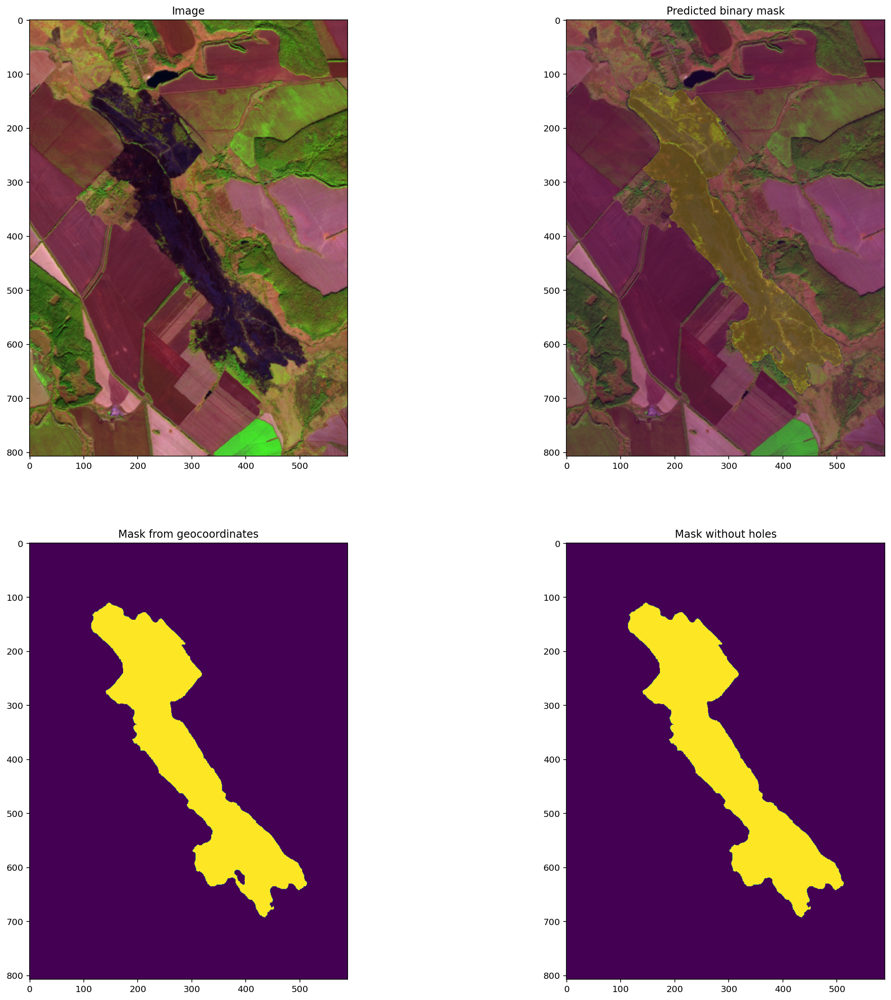

In [12]:
plot(
    image=img,
    binary_mask=mask,
    geo_polygons=geo_polygons,
    rasterio_dataset=ds,
    approx_polygons=approximate_geo_polygons,
)

<a id='sizes'></a>

## Different image sizes for big burnt areas

In [13]:
model, device = get_torch_model(TORCH_MODEL_PATH, device=DEVICE)

Using device: cuda


In [14]:
single_path = TIFF_PATH[24]
MASK_THRESHOLD = 0.99
IMG_SIZE_0 = 384
IMG_SIZE_1 = 1024
INTERSECTION = 0.1
AREA_THRESHOLD = 100

In [15]:
ds = get_dataset(path=single_path)
dict_meta = get_meta(path=single_path)
img = get_image(
    rasterio_dataset=ds, chanels=dict_meta["model_chanels"], img_size=IMG_SIZE_0
)
if img is not None:
    list_coord = get_cut_coord(image=img, img_size=IMG_SIZE, intersection=INTERSECTION)
    list_images = cut_image(image=img, sliding_window_coordinates=list_coord, norm=True)

In [16]:
masks = torch_predict(
    model=model,
    device=device,
    array_images=list_images,
    max_batch_size=MAX_BATCH_SIZE,
)
mask = prediction_to_mask(
    image=img,
    list_masks=masks,
    sliding_window_coordinates=list_coord,
    threshold=MASK_THRESHOLD,
)

In [17]:
mask_part = np.sum(mask == 1) / (img.shape[1] * img.shape[2])
print(f"Burnt area is {np.round(mask_part*100, 2)}% of tile size")

Burnt area is 43.82% of tile size


In [18]:
if IMG_SIZE_1 > img.shape[1] or IMG_SIZE_1 > img.shape[2]:
    IMG_SIZE_1 = (np.min([img.shape[1], img.shape[2]]) // 32 - 1) * 32

In [19]:
if mask_part > 0.3:
    img = get_image(
        rasterio_dataset=ds, chanels=dict_meta["model_chanels"], img_size=IMG_SIZE_1
    )
    if img is not None:
        list_coord = get_cut_coord(
            image=img, img_size=IMG_SIZE_1, intersection=INTERSECTION
        )
        list_images = cut_image(
            image=img, sliding_window_coordinates=list_coord, norm=True
        )
        masks = torch_predict(
            model=model,
            device=device,
            array_images=list_images,
            max_batch_size=MAX_BATCH_SIZE,
        )
        mask = prediction_to_mask(
            image=img,
            list_masks=masks,
            sliding_window_coordinates=list_coord,
            threshold=MASK_THRESHOLD,
        )

In [20]:
%%time
all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
list_big_polygons = area_filter(
    all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
)
img_coord = [
    all_img_coord[i] for i in range(len(all_img_coord)) if i in list_big_polygons
]
img_polygons = coordinates_to_polygons(coordinates=img_coord)
geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
list_true_polygons, list_holes = detect_holes(
    img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
)
approximate_geo_polygons = coordinates_to_polygons(
    coordinates=[geo_coord[x] for x in list_true_polygons]
)

dict_polygons = detect_inner_polygons(
    img_polygons=img_polygons,
    list_true_polygons=list_true_polygons,
    list_holes=list_holes,
)
geo_polygons = make_geo_polygons(
    dict_inner_polygons=dict_polygons,
    geo_coordinates=geo_coord,
    list_true_polygons=list_true_polygons,
)

CPU times: user 1.4 s, sys: 23.6 ms, total: 1.42 s
Wall time: 1.42 s


In [21]:
len(geo_polygons)

5

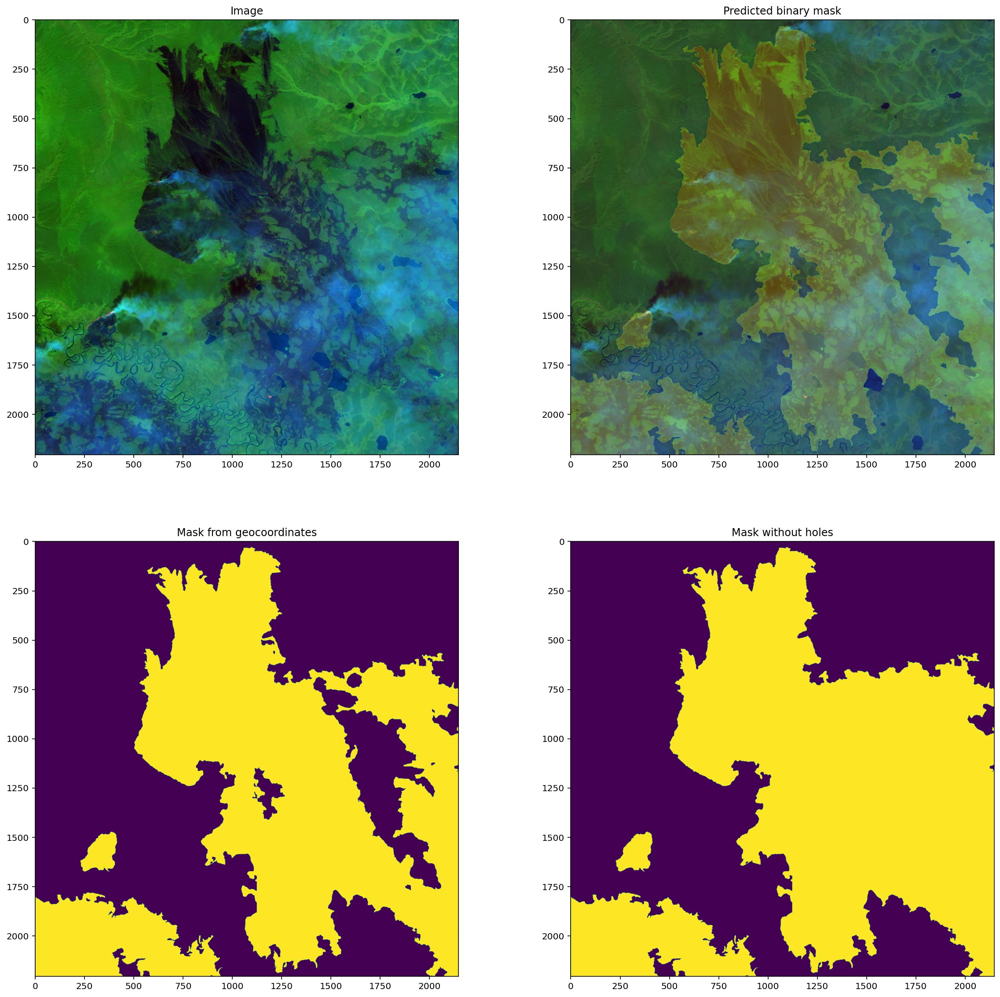

In [22]:
plot(
    image=img,
    binary_mask=mask,
    geo_polygons=geo_polygons,
    rasterio_dataset=ds,
    approx_polygons=approximate_geo_polygons,
)

<a id='batch'></a>

## Batch processing - tiles from test region

In [23]:
IMG_SIZE = 384
DEVICE = "cuda"
MAX_BATCH_SIZE = 8
INTERSECTION = 0.2
MASK_THRESHOLD = 0.99
AREA_THRESHOLD = 100
TRITON_MODEL_NAME = "model1"

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


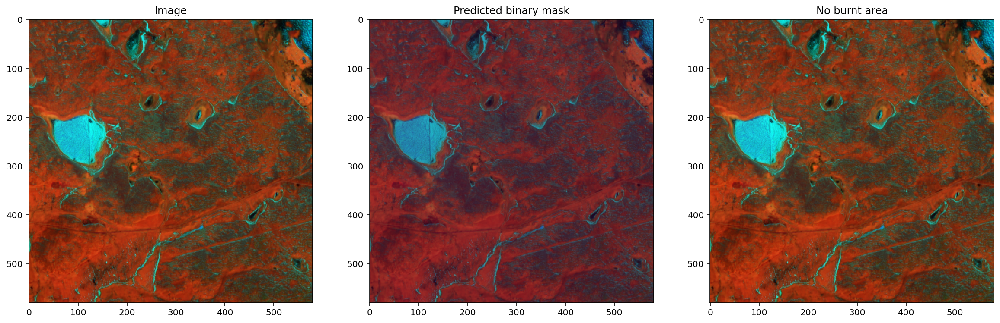

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


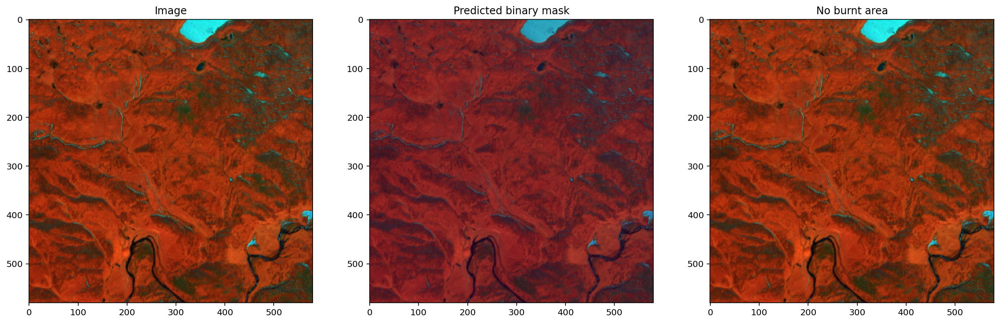

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


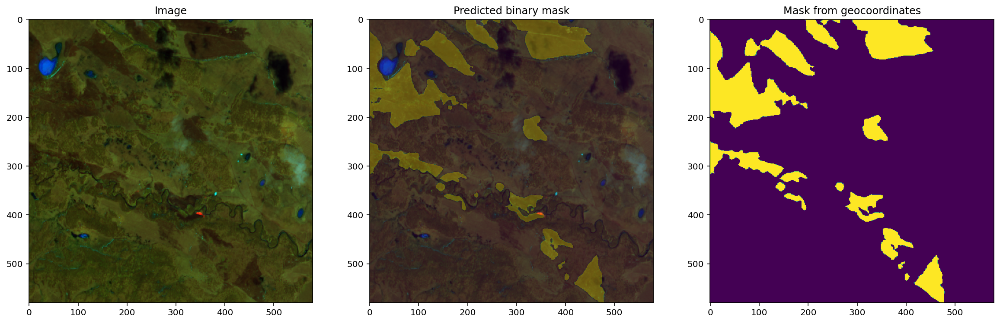

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


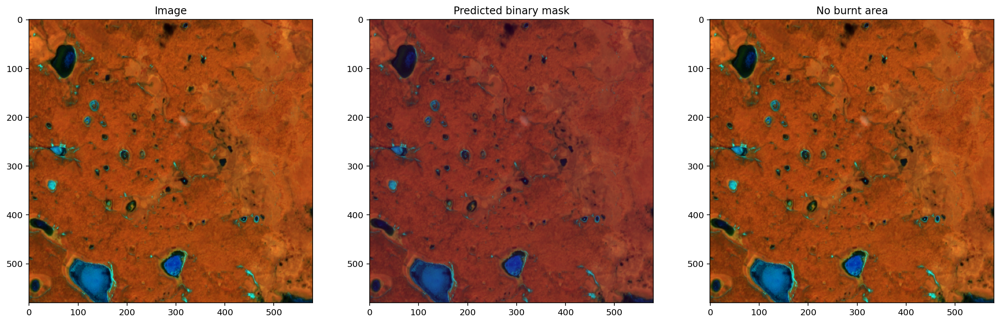

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


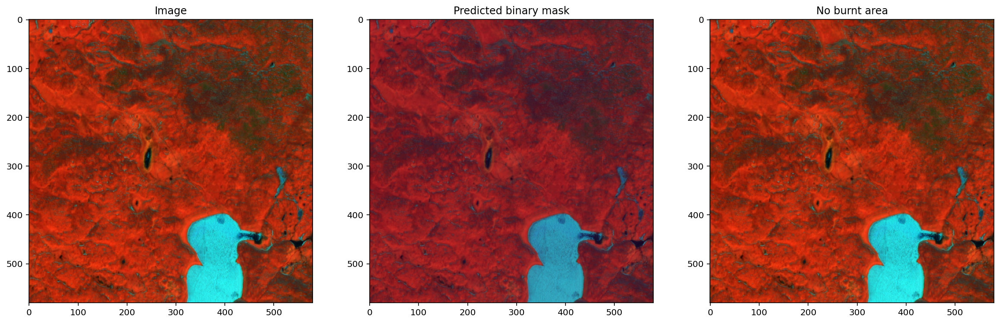

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


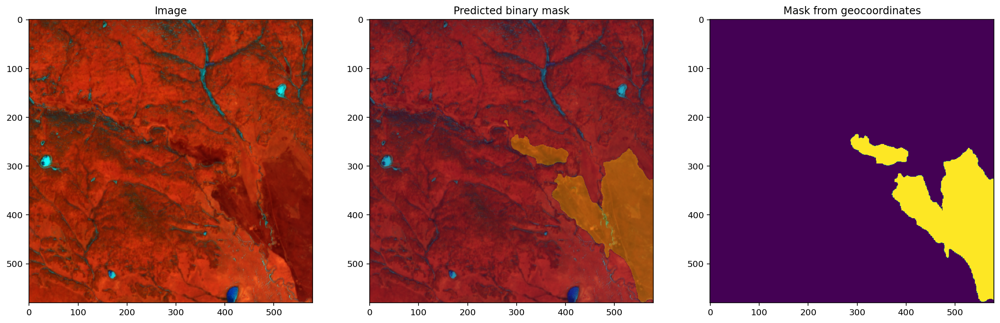

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


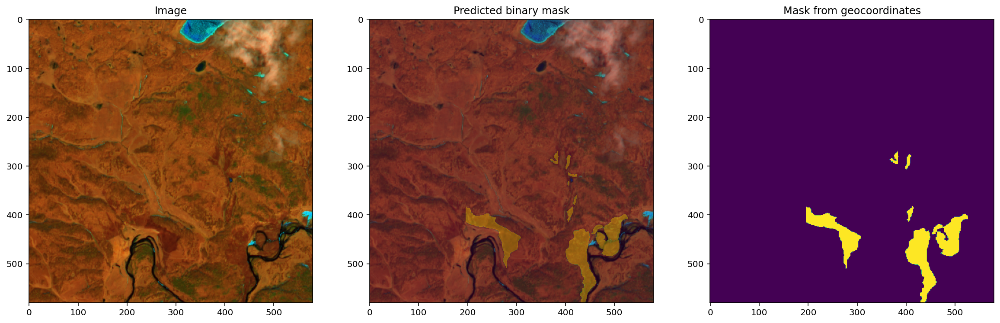

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


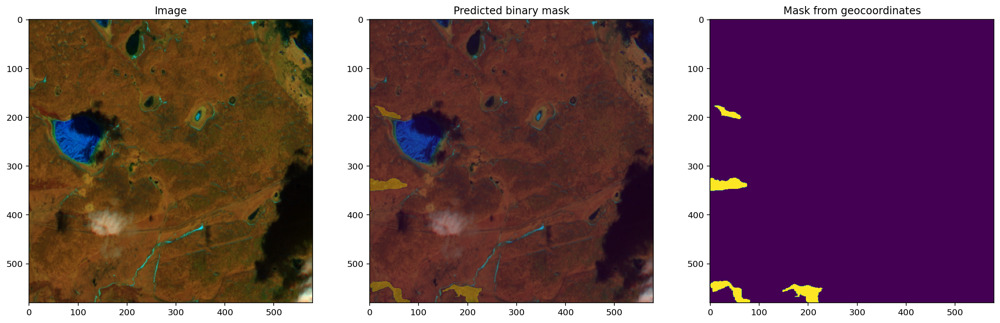

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


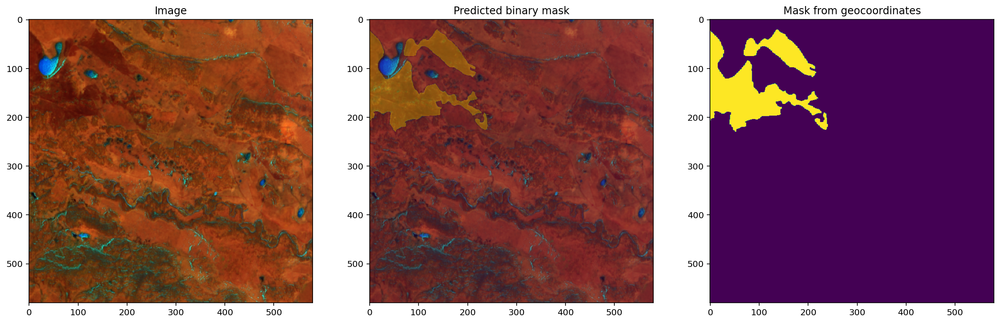

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


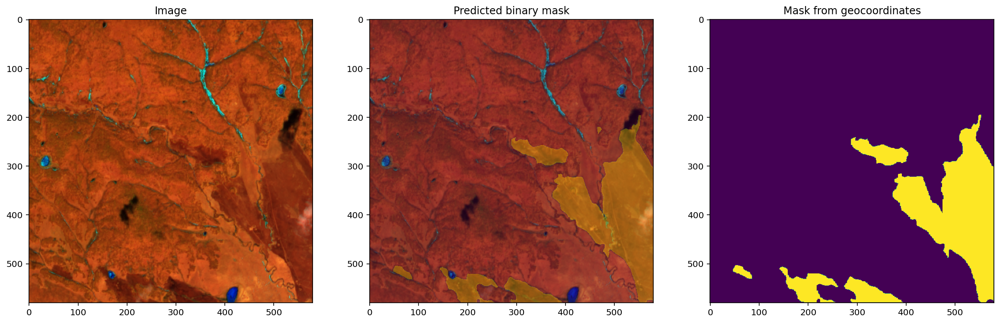

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


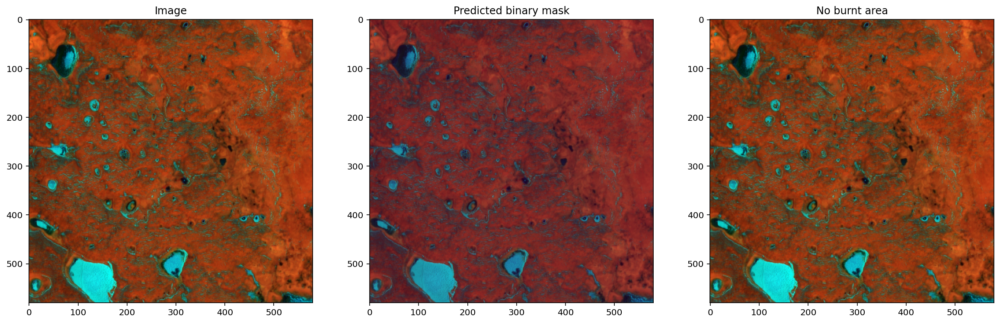

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


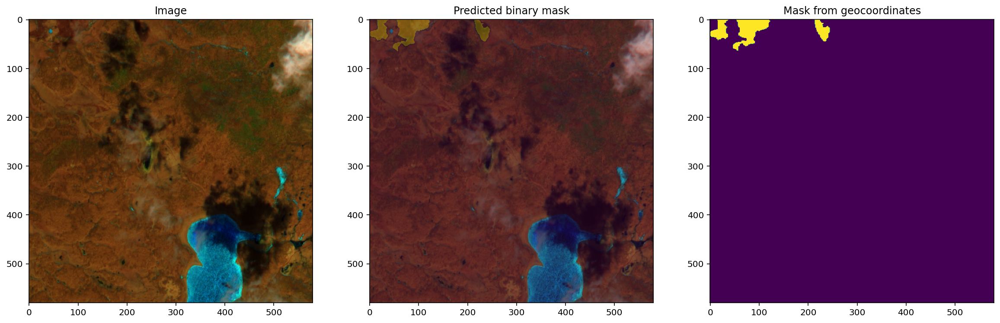

CPU times: user 25 s, sys: 3.25 s, total: 28.3 s
Wall time: 22.8 s


In [24]:
%%time
TEST_REGION_PATH = glob.glob("/app/data/ig_tiff_21/*/")

for single_path in TEST_REGION_PATH:
    ds = get_dataset(path=single_path)
    dict_meta = get_meta(path=single_path)
    img = get_image(
        rasterio_dataset=ds,
        chanels=dict_meta["model_chanels"],
        img_size=IMG_SIZE,
        disable_rasterio_warning=False,
    )
    if img is not None:
        list_coord = get_cut_coord(
            image=img, img_size=IMG_SIZE, intersection=INTERSECTION
        )
        list_images = cut_image(
            image=img, sliding_window_coordinates=list_coord, norm=True
        )
    if TRITON:
        masks = triton_predict(
            array_images=list_images,
            triton_http_service_url=TRITON_HTTP_SERVICE_URL,
            max_batch_size=MAX_BATCH_SIZE,
            model_name=TRITON_MODEL_NAME,
        )
    else:
        masks = torch_predict(
            model=model,
            device=device,
            array_images=list_images,
            max_batch_size=MAX_BATCH_SIZE,
        )
    mask = prediction_to_mask(
        image=img,
        list_masks=masks,
        sliding_window_coordinates=list_coord,
        threshold=MASK_THRESHOLD,
    )
    all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
    all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
    list_big_polygons = area_filter(
        all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
    )
    img_coord = [
        all_img_coord[i] for i in range(len(all_img_coord)) if i in list_big_polygons
    ]
    img_polygons = coordinates_to_polygons(coordinates=img_coord)
    geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
    list_true_polygons, list_holes = detect_holes(
        img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
    )
    approximate_geo_polygons = coordinates_to_polygons(
        coordinates=[geo_coord[x] for x in list_true_polygons]
    )

    dict_polygons = detect_inner_polygons(
        img_polygons=img_polygons,
        list_true_polygons=list_true_polygons,
        list_holes=list_holes,
    )
    geo_polygons = make_geo_polygons(
        dict_inner_polygons=dict_polygons,
        geo_coordinates=geo_coord,
        list_true_polygons=list_true_polygons,
    )
    plot(
        image=img,
        binary_mask=mask,
        geo_polygons=geo_polygons,
        rasterio_dataset=ds,
        approx_polygons=None,
    )
plt.show();

<a id='convert'></a>

## Converting model.pth to "onnx" format

In [25]:
pth_to_onnx(
    torch_model_path="/app/models/model1.pth",
    onnx_path="/app/models/onnx/",
    model_name="model",
    device="cuda",
    img_size=IMG_SIZE,
)